In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder
from sklearn.linear_model import LogisticRegression

df=pd.read_csv('attempts.csv')

estimators = [
    ('onehot', OneHotEncoder()),
    ('lr', LogisticRegression())
]
pipe = Pipeline(estimators)

# Just check the encoded variables
ohe = OneHotEncoder()
print(ohe.fit_transform(df[['student', 'problem']]))

pipe.fit(df[['student', 'problem']], df['solved'])
print(pipe.predict_proba(df[['student', 'problem']]))
cofs=pipe[1].coef_

theta=pd.Series(index=np.sort(df.student.unique()),data=cofs.reshape(-1,)[:-85])
diffik=pd.Series(index=np.sort(df.problem.unique()),data=cofs.reshape(-1,)[-85:])


scv=(-diffik).sort_values().index.values
po=[]
for j in df.problem.values:
    po.append((np.where(scv==j)[0]+1)[0])
df.problem=po    

skv=theta.sort_values().index.values
po=[]
for j in df.student.values:
    po.append((np.where(skv==j)[0]+1)[0])
df.student=po    

diffik=pd.Series(index=np.sort(df.problem.unique()),data=diffik.sort_values().values)
theta=pd.Series(index=np.sort(df.student.unique()),data=theta.sort_values().values)

  (0, 1)	1.0
  (0, 20557)	1.0
  (1, 1)	1.0
  (1, 20567)	1.0
  (2, 1)	1.0
  (2, 20565)	1.0
  (3, 1)	1.0
  (3, 20569)	1.0
  (4, 1)	1.0
  (4, 20566)	1.0
  (5, 1)	1.0
  (5, 20556)	1.0
  (6, 1)	1.0
  (6, 20558)	1.0
  (7, 1)	1.0
  (7, 20603)	1.0
  (8, 1)	1.0
  (8, 20572)	1.0
  (9, 1)	1.0
  (9, 20563)	1.0
  (10, 2)	1.0
  (10, 20557)	1.0
  (11, 2)	1.0
  (11, 20585)	1.0
  (12, 2)	1.0
  :	:
  (285798, 20640)	1.0
  (285799, 20554)	1.0
  (285799, 20569)	1.0
  (285800, 20554)	1.0
  (285800, 20580)	1.0
  (285801, 20554)	1.0
  (285801, 20563)	1.0
  (285802, 20554)	1.0
  (285802, 20565)	1.0
  (285803, 20554)	1.0
  (285803, 20567)	1.0
  (285804, 20554)	1.0
  (285804, 20574)	1.0
  (285805, 20554)	1.0
  (285805, 20575)	1.0
  (285806, 20495)	1.0
  (285806, 20604)	1.0
  (285807, 20555)	1.0
  (285807, 20605)	1.0
  (285808, 20555)	1.0
  (285808, 20598)	1.0
  (285809, 20555)	1.0
  (285809, 20569)	1.0
  (285810, 20555)	1.0
  (285810, 20620)	1.0


/opt/homebrew/anaconda3/envs/newenv/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[[0.01447939 0.98552061]
 [0.0060792  0.9939208 ]
 [0.00706871 0.99293129]
 ...
 [0.03005869 0.96994131]
 [0.04542564 0.95457436]
 [0.12874894 0.87125106]]


In [4]:
import numpy as np
import torch
import tqdm
from torch import nn
from torch.autograd import Variable
from sklearn.metrics import roc_auc_score


In [5]:
#start by doing a dataframe of the history success for each student 
ohe=OneHotEncoder()
l=ohe.fit_transform(df[['problem','solved']])
stud_list={}
for j in df.student.unique():
    stud_list[j]=df[df.student==j][['problem','solved']]
encoded_l={}
for j in df.student.unique():
    encoded_l[j]=l[stud_list[j].index]


good_list={}
for j in df.student.unique():
    m=encoded_l[j].toarray()
    good_list[j]=torch.zeros(len(m),170)
    for i in range(len(m)):
        if m[i,-2]:
            good_list[j][i][:85]=torch.Tensor(m[i,:-2])
        else:
            good_list[j][i][-85:]=torch.Tensor(m[i,:-2])
            
 
mm=np.split(df.student.unique(),3)
np.r_[mm[0],mm[1]]
train_l={good_list[j] for j in np.r_[mm[0],mm[1]] }
test_l={good_list[j] for j in mm[2]}                   

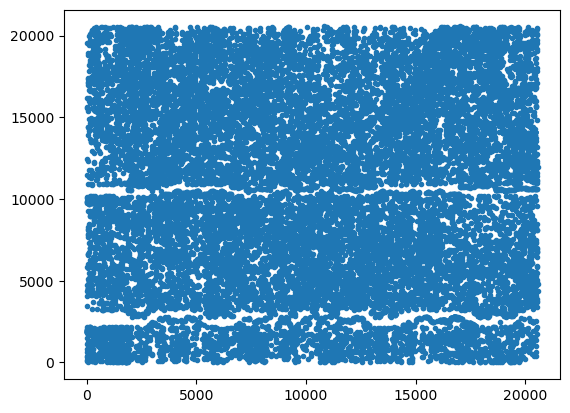

In [458]:
plt.plot(df.student.unique(),'.')

,problem,solved
239561,14,True
239564,11,True
239565,9,True
239567,8,True
239571,4,True
...,...,...
240160,7,True
240161,5,True
240162,10,True
240163,3,True


In [356]:
def process_raw_pred(raw_question_matrix, raw_pred, num_questions: int) -> tuple:
    questions = torch.nonzero(raw_question_matrix)% num_questions
    length = questions.shape[0]
    
    pred = raw_pred[questions.T.numpy()]
    
    truth = (torch.nonzero(raw_question_matrix)[:,1]>84).float()
    
    return pred,truth

In [283]:
zee=(torch.nonzero(zz)[:,1]>84).float()
loss=nn.BCELoss()
loss(zee,pred)



tensor(72.5784)

In [334]:
model(zz[:,None,:])

/var/folders/rh/v2m3z36j1j71mqlvn91zps5c0000gn/T/ipykernel_21487/3923913605.py:29: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  out=self.softy(out)


tensor([[0.0113, 0.0160, 0.0117, 0.0082, 0.0089, 0.0156, 0.0068, 0.0186, 0.0153,
         0.0126, 0.0073, 0.0205, 0.0102, 0.0123, 0.0076, 0.0206, 0.0141, 0.0124,
         0.0095, 0.0084, 0.0090, 0.0134, 0.0095, 0.0094, 0.0107, 0.0198, 0.0082,
         0.0236, 0.0065, 0.0098, 0.0110, 0.0116, 0.0147, 0.0158, 0.0078, 0.0071,
         0.0072, 0.0103, 0.0073, 0.0096, 0.0129, 0.0209, 0.0084, 0.0106, 0.0127,
         0.0081, 0.0090, 0.0114, 0.0057, 0.0079, 0.0093, 0.0160, 0.0128, 0.0097,
         0.0191, 0.0072, 0.0057, 0.0177, 0.0135, 0.0087, 0.0186, 0.0100, 0.0148,
         0.0158, 0.0107, 0.0090, 0.0108, 0.0129, 0.0076, 0.0129, 0.0126, 0.0125,
         0.0138, 0.0157, 0.0116, 0.0099, 0.0106, 0.0144, 0.0073, 0.0114, 0.0187,
         0.0105, 0.0110, 0.0072, 0.0120],
        [0.0110, 0.0156, 0.0129, 0.0078, 0.0094, 0.0124, 0.0067, 0.0159, 0.0161,
         0.0147, 0.0071, 0.0178, 0.0088, 0.0131, 0.0085, 0.0216, 0.0125, 0.0110,
         0.0105, 0.0091, 0.0100, 0.0123, 0.0101, 0.0089, 0.0095, 0.

In [305]:
zz[:,None,:].size(1)

1

In [462]:
import torch
import torch.nn as nn

class SimpleRNN(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size):
        super(SimpleRNN, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        
        # Define the RNN layer
        self.rnn = nn.RNN(input_size, hidden_size, num_layers)
        
        # Define the output layer
        self.fc = nn.Linear(hidden_size, output_size)

        self.softy=torch.nn.Softmax()
        
    
    def forward(self, x):
        # Initialize hidden state with zeros
        
        h0 = torch.zeros(self.num_layers, x.size(1),self.hidden_size).to(x.device)
        
        # Forward propagate RNN
        out, _ = self.rnn(x, h0)
        
        # Decode the hidden state of the last time step
        out = self.fc(out[:, -1, :])
        out=self.softy(out)
        return out

# Define the hyperparameters
input_size = 170
hidden_size = 5
num_layers = 5
output_size = 85

# Initialize the RNN model
model = SimpleRNN(input_size, hidden_size, num_layers, output_size)

# Print the model architecture
print(model)


SimpleRNN(
  (rnn): RNN(170, 5, num_layers=5)
  (fc): Linear(in_features=5, out_features=85, bias=True)
  (softy): Softmax(dim=None)
)


['T_destination',
 '__annotations__',
 '__call__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattr__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_apply',
 '_backward_hooks',
 '_buffers',
 '_call_impl',
 '_forward_hooks',
 '_forward_pre_hooks',
 '_get_backward_hooks',
 '_get_name',
 '_is_full_backward_hook',
 '_load_from_state_dict',
 '_load_state_dict_post_hooks',
 '_load_state_dict_pre_hooks',
 '_maybe_warn_non_full_backward_hook',
 '_modules',
 '_named_members',
 '_non_persistent_buffers_set',
 '_parameters',
 '_register_load_state_dict_pre_hook',
 '_register_state_dict_hook',
 '_replicate_for_data_parallel',
 '_save_to_state_dict',
 '_slow_forward',
 '_state_dict_hooks',
 '_ver

In [37]:
class lossFunc(nn.Module):
    def __init__(self, num_of_questions, max_step, device):
        super(lossFunc, self).__init__()
        self.crossEntropy = nn.BCELoss()
        self.num_of_questions = num_of_questions
        self.max_step = max_step
        self.device = device

    def forward(self, pred, batch):
        loss = 0
        prediction = torch.tensor([], device=self.device)
        ground_truth = torch.tensor([], device=self.device)
        for student in range(pred.shape[0]):
            delta = batch[student][:, 0:self.num_of_questions] + batch[
                student][:, self.num_of_questions:]  # shape: [length, questions]
            temp = pred[student][:self.max_step - 1].mm(delta[1:].t())
            index = torch.tensor([[i for i in range(self.max_step - 1)]],
                                 dtype=torch.long, device=self.device)
            p = temp.gather(0, index)[0]
            a = (((batch[student][:, 0:self.num_of_questions] -
                   batch[student][:, self.num_of_questions:]).sum(1) + 1) //
                 2)[1:]
            for i in range(len(p) - 1, -1, -1):
                if p[i] > 0:
                    p = p[:i + 1]
                    a = a[:i + 1]
                    break
            loss += self.crossEntropy(p, a)
            prediction = torch.cat([prediction, p])
            ground_truth = torch.cat([ground_truth, a])
        return loss, prediction, ground_truth

In [463]:
import torch
import torch.nn as nn
import torch.optim as optim

def train_rnn(model, train_loader, num_epochs, learning_rate):
    # Define the loss function and optimizer
    criterion = nn.BCELoss(reduction='mean')
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)
    
    # Training loop
    for epoch in range(num_epochs):
        for student in train_loader:
            # Forward pass
            pred_student=model(student[:,None,:])
        
            outputs,targets=process_raw_pred(student,pred_student,output_size)
            
            loss = criterion( outputs,targets)
            
            # Backward pass and optimization
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
        
        # Print the loss for this epoch
        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')
    
    print('Training finished.')

# Example usage:
# train_loader is your data loader containing (input, target) pairs
# num_epochs is the number of training epochs
# learning_rate is the learning rate for optimization

# train_rnn(model, train_loader, num_epochs=10, learning_rate=0.001)


In [464]:
train_rnn(model,train_l,num_epochs=20,learning_rate=0.002)

/var/folders/rh/v2m3z36j1j71mqlvn91zps5c0000gn/T/ipykernel_21487/858118980.py:29: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  out=self.softy(out)


Epoch [1/20], Loss: 1.1187
Epoch [2/20], Loss: 0.9253
Epoch [3/20], Loss: 0.8464
Epoch [4/20], Loss: 0.6831
Epoch [5/20], Loss: 0.5664
Epoch [6/20], Loss: 0.5246
Epoch [7/20], Loss: 0.4716
Epoch [8/20], Loss: 0.5052
Epoch [9/20], Loss: 0.3948
Epoch [10/20], Loss: 0.3297
Epoch [11/20], Loss: 0.3534
Epoch [12/20], Loss: 0.2377
Epoch [13/20], Loss: 0.2705
Epoch [14/20], Loss: 0.2070
Epoch [15/20], Loss: 0.1945
Epoch [16/20], Loss: 0.1824
Epoch [17/20], Loss: 0.1661
Epoch [18/20], Loss: 0.1500
Epoch [19/20], Loss: 0.1336
Epoch [20/20], Loss: 0.1144
Training finished.


In [370]:
criterion = nn.BCELoss(reduction='mean')

In [465]:
import torch
import torch.nn as nn

def test_rnn(model, test_loader, criterion):
    model.eval()  # Set the model to evaluation mode
    total_loss = 0.0
    num_samples = 0
    
    with torch.no_grad():  # Disable gradient tracking during inference
        for student in test_l:
            # Forward pass
            pred_student=model(student[:,None,:])
        
            outputs,targets=process_raw_pred(student,pred_student,output_size)
            
            # Compute the loss
            loss = criterion(outputs, targets)
            
            # Update the total loss and the number of samples
            total_loss += loss.item()
            num_samples += 1
    
    # Calculate the average test loss
    average_loss = total_loss / num_samples
    
    # Print or return the test results (you can customize this)
    print(f"Average Test Loss: {average_loss:.4f}")
    
    # Optionally, you can return additional evaluation metrics

# Example usage:
# test_loader is your data loader containing (input, target) pairs for testing
# criterion is your loss function (e.g., nn.MSELoss)

# test_rnn(model, test_loader, criterion)


In [466]:
test_rnn(model,test_l,criterion)

/var/folders/rh/v2m3z36j1j71mqlvn91zps5c0000gn/T/ipykernel_21487/858118980.py:29: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  out=self.softy(out)


Average Test Loss: 0.0787


In [376]:
ce=next(iter(test_l))

In [390]:
suca={ j:next(iter(test_l)) for j in range(len(test_l))}

In [409]:
student=new_dict[mm[2][0]]


pred_student=model(student[:,None,:])

outputs,targets=process_raw_pred(student,pred_student,output_size)

/var/folders/rh/v2m3z36j1j71mqlvn91zps5c0000gn/T/ipykernel_21487/2496721967.py:29: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  out=self.softy(out)


In [469]:
model(suca[6851][:,None,:])[-1]

/var/folders/rh/v2m3z36j1j71mqlvn91zps5c0000gn/T/ipykernel_21487/858118980.py:29: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  out=self.softy(out)


tensor([9.0000e-17, 1.0347e-22, 9.9790e-01, 6.9322e-42, 9.3011e-05, 1.8275e-19,
        3.5989e-12, 1.3077e-27, 6.0738e-06, 1.3633e-04, 2.7805e-14, 1.2776e-07,
        3.6458e-10, 3.4228e-25, 1.5036e-09, 4.6068e-07, 1.0588e-21, 3.2154e-11,
        9.7853e-40, 1.4703e-15, 4.5569e-10, 4.1548e-19, 4.9156e-35, 8.2311e-26,
        1.4039e-06, 1.5768e-13, 1.8610e-03, 7.3458e-17, 4.7562e-22, 9.7323e-11,
        2.7445e-32, 2.8201e-10, 8.4445e-22, 2.9117e-24, 3.3170e-16, 1.2756e-14,
        1.9289e-27, 4.5217e-26, 5.5534e-17, 3.6343e-20, 3.3939e-10, 1.6145e-22,
        2.4207e-11, 1.1762e-20, 1.8800e-14, 8.1940e-17, 7.0230e-17, 2.4870e-12,
        5.1522e-17, 1.1836e-13, 1.9493e-19, 1.9138e-16, 2.6218e-12, 1.9057e-11,
        5.1017e-21, 4.0633e-15, 1.0284e-15, 3.6435e-17, 1.0033e-17, 1.6316e-14,
        3.9532e-16, 5.2860e-18, 1.5629e-10, 2.8292e-14, 5.7244e-12, 1.6955e-13,
        7.8746e-15, 2.6815e-16, 1.2372e-14, 2.5142e-16, 2.3379e-13, 4.1274e-17,
        1.0997e-16, 1.8637e-16, 8.0242e-

/var/folders/rh/v2m3z36j1j71mqlvn91zps5c0000gn/T/ipykernel_21487/858118980.py:29: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  out=self.softy(out)


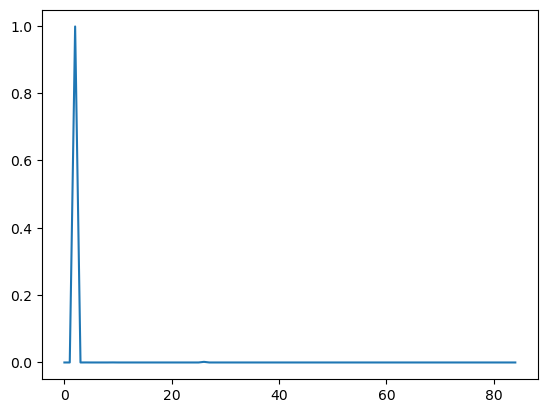

In [467]:
plt.plot(model(suca[6851][:,None,:])[-1].detach().numpy())

In [385]:
model(ce[:,None,:]).shape

/var/folders/rh/v2m3z36j1j71mqlvn91zps5c0000gn/T/ipykernel_21487/2496721967.py:29: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  out=self.softy(out)


torch.Size([4, 85])

In [408]:
new_dict[mm[2][0]].shape

torch.Size([4, 170])

In [381]:
ce.shape

torch.Size([4, 170])

In [401]:
vu={j:next(iter(test_l)) for j in range(len(test_l))}

In [406]:
new_dict[mm[2][0]].shape

torch.Size([4, 170])

In [404]:
# Step 1: Create a dictionary with the current keys and values


# Step 2: Create a mapping from old keys to new keys
key_mapping = {j:mm[2][j] for j in range(len(vu))}

# Step 3: Create a new dictionary with the updated keys
new_dict = {key_mapping.get(old_key, old_key): value for old_key, value in vu.items()}

# Print the new dictionary
print(new_dict)


{15364: tensor([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.